## Imports

In [1]:
from inspect import signature
import matplotlib.pyplot as plt
import numpy as np
import optuna
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.base import BaseEstimator, TransformerMixin, clone
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import IsolationForest, RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.metrics import (ConfusionMatrixDisplay, accuracy_score,
                             confusion_matrix, f1_score, matthews_corrcoef,
                             precision_score, recall_score)
from sklearn.model_selection import cross_val_predict, train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer, StandardScaler
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap


2024-11-24 14:09:45.268424: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1732453785.679629   42564 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1732453785.794365   42564 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-24 14:09:46.766758: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


## Data Load


In [2]:
x_df = pd.read_csv('../data/features5.csv')
# x_df.drop(columns=['avg_stickied'], inplace=True)
y_df = pd.read_csv('../data/labels.csv')

display(x_df.head())
display(y_df.head())
x_df.shape, y_df.shape, x_df.columns, y_df.columns

,username,link_karma,comment_karma,account_age,is_verified,avg_cosine_similarity,all_users_similarity,avg_comment_length,max_comment_length,min_comment_length,comment_post_ratio,avg_thread_depth,parent_child_similarity,avg_ttr,avg_flesch_kincaid_grade,ngram_overlap,avg_score,avg_num_replies
0,yakfsh1,19830.0,88232.0,1440.0,True,1.0,0.019249,368.00,368.0,368.0,1.0,0.666667,0.030395,0.955981,9.20000,0.002070,1173.666667,2.111111
1,Tsquare43,699100.0,720902.0,3636.0,True,1.0,0.015121,62.00,62.0,62.0,1.0,1.619048,0.037736,0.955845,7.07619,0.000198,26.571429,0.333333
2,SeaSpeakToMe,236.0,11628.0,1029.0,True,NaN,0.012001,90.25,141.0,64.0,1.0,1.000000,0.121246,1.000000,1.30000,0.000000,3.000000,0.000000
3,hurtingxliving,848.0,1275.0,2001.0,True,NaN,0.014932,37.00,37.0,37.0,1.0,0.000000,0.000000,0.888889,12.60000,0.000000,6.000000,0.000000
4,Minute-Photo6916,1.0,4.0,12.0,True,NaN,0.008529,15.00,15.0,15.0,1.0,1.000000,0.000000,1.000000,-2.30000,0.000000,5.000000,0.000000


,username,is_bot
0,yakfsh1,False
1,Tsquare43,False
2,SeaSpeakToMe,False
3,hurtingxliving,False
4,Minute-Photo6916,False


((319174, 18),
 (319174, 2),
 Index(['username', 'link_karma', 'comment_karma', 'account_age', 'is_verified',
        'avg_cosine_similarity', 'all_users_similarity', 'avg_comment_length',
        'max_comment_length', 'min_comment_length', 'comment_post_ratio',
        'avg_thread_depth', 'parent_child_similarity', 'avg_ttr',
        'avg_flesch_kincaid_grade', 'ngram_overlap', 'avg_score',
        'avg_num_replies'],
       dtype='object'),
 Index(['username', 'is_bot'], dtype='object'))

In [3]:
y_df['is_bot'].value_counts()

is_bot
False    310526
True       8648
Name: count, dtype: int64

In [4]:
x_df = x_df.sort_values(by='username', ignore_index=True)
y_df = y_df.sort_values(by='username', ignore_index=True)

In [5]:
x_bot, y_bot = x_df[y_df['is_bot']].copy().reset_index(drop=True), y_df[y_df['is_bot']].copy().reset_index(drop=True)
x_user, y_user = x_df[~y_df['is_bot']].copy().reset_index(drop=True), y_df[~y_df['is_bot']].copy().reset_index(drop=True)

rand_state = 417
non_bot_multiplier = 2

x_user = x_user.sample(n=int(x_bot.shape[0] * non_bot_multiplier), random_state=rand_state).reset_index(drop=True)
y_user = y_user[y_user['username'].isin(x_user['username'])].reset_index(drop=True)

display(x_bot.shape, y_bot['is_bot'].value_counts()), display(x_user.shape, y_user['is_bot'].value_counts())


(8648, 18)

is_bot
True    8648
Name: count, dtype: int64

(17296, 18)

is_bot
False    17296
Name: count, dtype: int64

(None, None)

## Data preprocessing


In [6]:
def drop_columns(X, columns):
    return X.drop(columns, axis=1)


def replace_none(X, column_value_pairs):
    for column, value in column_value_pairs.items():
        X.loc[:, column] = X[column].fillna(value).infer_objects(copy=False)
    return X

def convert_bool(X, columns):
    for column in columns:
        X.loc[:, column] = X[column].apply(lambda x: 1 if x else 0)
    return X


def drop_rows_with_none(X, columns):
    return X.dropna(subset=columns)


In [7]:
class CustomStandardizer(BaseEstimator, TransformerMixin):
    def __init__(self, columns_to_standardize):
        self.columns_to_standardize = columns_to_standardize
        self.standard_scaler = StandardScaler()
        self.imputer = SimpleImputer(strategy='constant', fill_value=1)

    def fit(self, X, y=None):
        X = X.copy()
        without_none = X.dropna(subset=self.columns_to_standardize)
        self.standard_scaler.fit(without_none[self.columns_to_standardize])
        self.imputer.fit(X[self.columns_to_standardize])
        return self

    def transform(self, X, y=None):
        without_none = X.dropna(subset=self.columns_to_standardize)
        with_none = X[~X.index.isin(without_none.index)]
        X_standardized = self.standard_scaler.transform(without_none[self.columns_to_standardize])
        X_combined = np.hstack([X_standardized, without_none.drop(columns=self.columns_to_standardize, axis=1)])
        X_combined_df = pd.DataFrame(X_combined, index=without_none.index, columns=list(self.columns_to_standardize) + list(without_none.drop(columns=self.columns_to_standardize, axis=1).columns))
        X_final = pd.concat([X_combined_df, with_none], axis=0).sort_index()
        X_final[self.columns_to_standardize] = self.imputer.transform(X_final[self.columns_to_standardize])
        return X_final

    def fit_transform(self, X, y=None):
        return self.fit(X, y).transform(X)


class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, outlier_columns, contamination=0.05):
        self.outlier_columns = outlier_columns
        self.contamination = contamination
        self.clf = IsolationForest(n_estimators=100, contamination=self.contamination, random_state=42)

    def fit(self, X, y=None):
        X_copy = X[self.outlier_columns].copy()
        self.clf.fit(X_copy)
        return self

    def transform(self, X, y=None):
        X_copy = X[self.outlier_columns].copy()
        outliers = self.clf.predict(X_copy)
        mask = outliers == 1
        if y is None:
            return X[mask]
        else:
            return X[mask], y.loc[X[mask].index]
    
    def fit_transform(self, X, y=None):
        self.fit(X)
        return self.transform(X, y)


class CustomColumnTransformer(ColumnTransformer):
    def fit(self, X, y=None):
        if isinstance(X, tuple):
            X, y = X
        result = super().fit(X, y)
        return result, y

    def transform(self, X, y=None):
        y = None
        if isinstance(X, tuple):
            X, y = X
        result = super().transform(X)
        return result, y

    def fit_transform(self, X, y=None):
        if isinstance(X, tuple):
            X, y = X
        result = super().fit_transform(X, y)
        return result, y

In [8]:
columns_to_drop = ["username"]
to_standardization = [
    "avg_comment_length",
    "max_comment_length",
    "min_comment_length",
    "avg_flesch_kincaid_grade",
    "link_karma",
    "comment_karma",
    "account_age",
    "is_verified",
    "avg_score",
    "avg_num_replies",
]
columns_to_standardize_before_replace = [
    "comment_post_ratio",
]
columns_to_replace_none = {
    'avg_cosine_similarity': 0,
    'all_users_similarity': 0,
    'avg_thread_depth': 0,
    'avg_ttr': 0,
    'ngram_overlap': 0,
    "avg_comment_length": 0,
    "max_comment_length": 0,
    "min_comment_length": 0,
    "avg_flesch_kincaid_grade": 0,
    "link_karma": 0,
    "comment_karma": 0,
    "comment_post_ratio": 0,
    "account_age": 0,
    "is_verified": 0,
    "parent_child_similarity": 0,
    "avg_score": 0,
    "avg_num_replies": 0
}
columns_to_drop_none = [
    'link_karma',
    'comment_karma',
    'account_age',
    'is_verified',
]
columns_to_convert_bool = [
    'is_verified',
]
to_remove_outliers = [
    'link_karma',
    'comment_karma',
    "avg_comment_length",
    "max_comment_length",
    "min_comment_length",
]

In [9]:
none_transformer = Pipeline(
    steps=[
        ('drop_columns', FunctionTransformer(drop_columns, kw_args={'columns': columns_to_drop})),
        ('drop_rows_with_none', FunctionTransformer(drop_rows_with_none, kw_args={'columns': columns_to_drop_none})),
        ('convert_bool', FunctionTransformer(convert_bool, kw_args={'columns': columns_to_convert_bool})),
        ('replace_none_without_std', FunctionTransformer(replace_none, kw_args={'column_value_pairs': columns_to_replace_none})),
    ]
)

column_preprocessor = CustomColumnTransformer(
    transformers=[
        ('standardization', StandardScaler(), to_standardization),
        ('std_before_replace', CustomStandardizer(columns_to_standardize_before_replace), columns_to_standardize_before_replace),
    ], remainder='passthrough'
)

In [10]:
class CustomPipeline(Pipeline):
    def transform(self, X, y=None, **transform_params):
        Xt = X
        for _, name, transform in self._iter(with_final=False):
            if hasattr(transform, "transform"):
                # Check if transform accepts y as a parameter
                sig = signature(transform.transform)
                if "y" in sig.parameters:
                    Xt = transform.transform(Xt, y=y, **transform_params)
                else:
                    Xt = transform.transform(Xt, **transform_params)
        return Xt

In [11]:
preprocessing_pipeline = CustomPipeline(
    steps=[
        ('none_transformer', none_transformer),
        ('outlier_remover', OutlierRemover(to_remove_outliers)),
        ('column_preprocessor', column_preprocessor),
    ]
)

In [12]:
x_preprocessed, y_preprocessed = preprocessing_pipeline.fit_transform(x_df, pd.DataFrame(y_df['is_bot']))
X_user_preprocessed, y_user_preprocessed = preprocessing_pipeline.transform(x_user, pd.DataFrame(y_user['is_bot']))
X_bot_preprocessed, y__botpreprocessed = preprocessing_pipeline.transform(x_bot, pd.DataFrame(y_bot['is_bot']))

/tmp/ipykernel_42564/3790178958.py:7: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X.loc[:, column] = X[column].fillna(value).infer_objects(copy=False)
/tmp/ipykernel_42564/3790178958.py:7: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X.loc[:, column] = X[column].fillna(value).infer_objects(copy=False)
/tmp/ipykernel_42564/3790178958.py:7: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.se

## Distribution comparison

In [13]:
x_preprocessed_df = pd.DataFrame(x_preprocessed, columns=x_df.columns.drop('username'))
x_preprocessed_df.drop(columns=['is_verified'], inplace=True)
x_concat = pd.concat([x_preprocessed_df, y_preprocessed], axis=1)

### Jensen-shannon

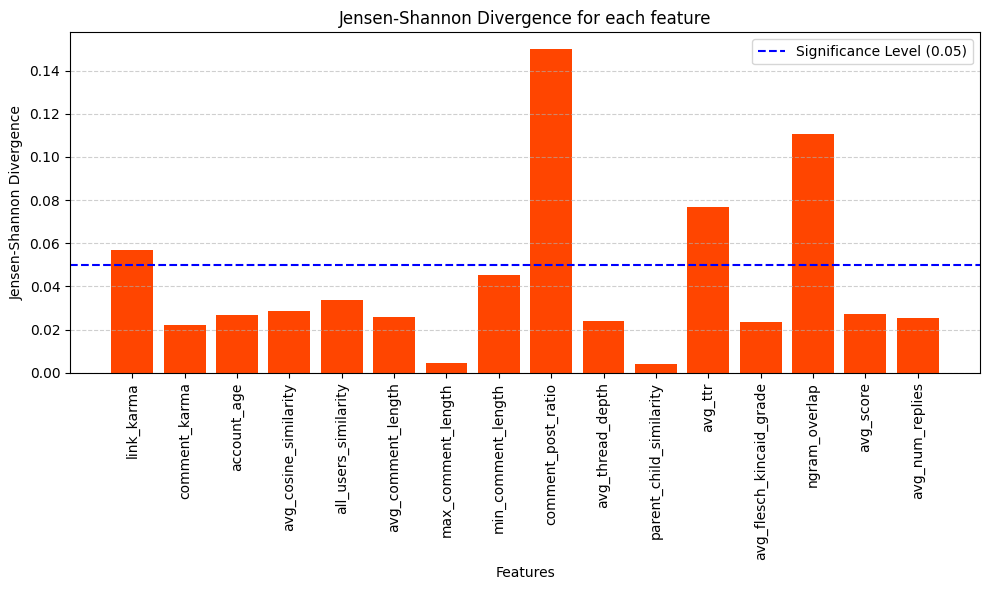

In [14]:
from scipy.spatial.distance import jensenshannon

# List of dependent variables
dependent_vars = [
    'link_karma', 'comment_karma', 'account_age', 
    'avg_cosine_similarity', 'all_users_similarity', 'avg_comment_length', 
    'max_comment_length', 'min_comment_length', 'comment_post_ratio', 
    'avg_thread_depth', 'parent_child_similarity', 'avg_ttr', 
    'avg_flesch_kincaid_grade', 'ngram_overlap', 'avg_score', 'avg_num_replies'
]

# Store JSD values
jsd_values = []

# Calculate JSD for each dependent variable
for var in dependent_vars:
    group1 = x_concat[x_concat['is_bot'] == 0][var].dropna()
    group2 = x_concat[x_concat['is_bot'] == 1][var].dropna()
    
    # Calculate histograms
    hist1, bin_edges1 = np.histogram(group1, bins=30, density=True)
    hist2, bin_edges2 = np.histogram(group2, bins=30, density=True)
    
    # Normalize histograms to get probability distributions
    hist1 = hist1 / np.sum(hist1)
    hist2 = hist2 / np.sum(hist2)
    
    # Calculate JSD
    jsd = jensenshannon(hist1, hist2)
    jsd_values.append(jsd)

# Plotting
plt.figure(figsize=(10, 6))
plt.grid(True, axis='y', linestyle='--', alpha=0.6)
plt.bar(dependent_vars, jsd_values, color='#FF4500')
plt.xlabel('Features')
plt.ylabel('Jensen-Shannon Divergence')
plt.title('Jensen-Shannon Divergence for each feature')
plt.xticks(rotation=90)
plt.axhline(y=0.05, color='blue', linestyle='--', label='Significance Level (0.05)')
plt.tight_layout()
plt.legend()
plt.show()

### Wasserstein distance

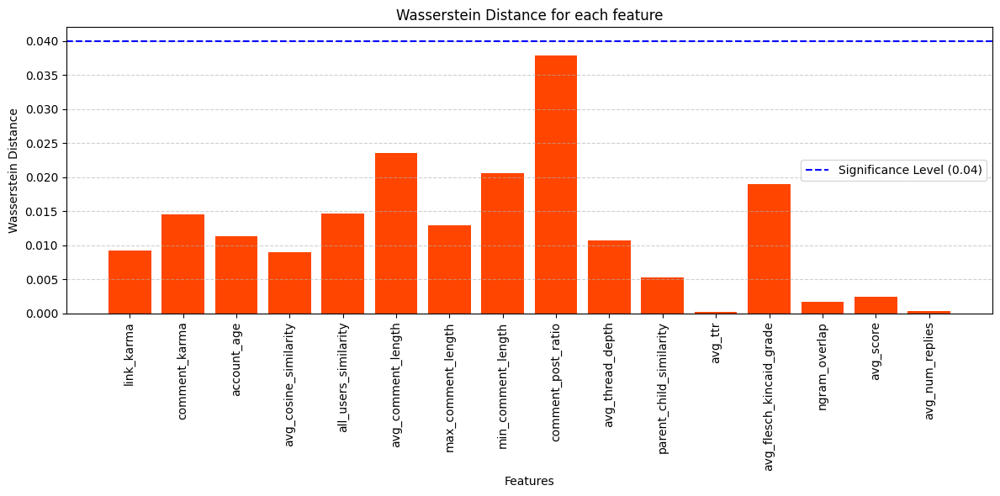

In [15]:
from scipy.stats import wasserstein_distance

dependent_vars = [
    'link_karma', 'comment_karma', 'account_age', 
    'avg_cosine_similarity', 'all_users_similarity', 'avg_comment_length', 
    'max_comment_length', 'min_comment_length', 'comment_post_ratio', 
    'avg_thread_depth', 'parent_child_similarity', 'avg_ttr', 
    'avg_flesch_kincaid_grade', 'ngram_overlap', 'avg_score', 'avg_num_replies'
]

# Store Wasserstein distance values
wasserstein_values = []

# Calculate Wasserstein distance for each dependent variable
for var in dependent_vars:
    group1 = x_concat[x_concat['is_bot'] == 0][var].dropna()
    group2 = x_concat[x_concat['is_bot'] == 1][var].dropna()
    
    # Calculate Wasserstein distance
    distance = wasserstein_distance(group1, group2)
    wasserstein_values.append(distance)

# Plotting
plt.figure(figsize=(12, 6))
plt.bar(dependent_vars, wasserstein_values, color='#FF4500')
plt.xlabel('Features')
plt.ylabel('Wasserstein Distance')
plt.title('Wasserstein Distance for each feature')
plt.xticks(rotation=90)
plt.axhline(y=0.04, color='blue', linestyle='--', label='Significance Level (0.04)')
plt.grid(True, axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.legend()
plt.show()

## Plotly feature distribution

In [16]:
x_bot_prepr_df = pd.DataFrame(X_bot_preprocessed, columns=x_df.columns[1:])
x_user_prepr_df = pd.DataFrame(X_user_preprocessed, columns=x_df.columns[1:])

x_bot_prepr_df['is_bot'] = 1
x_user_prepr_df['is_bot'] = 0

merged_df = pd.concat([x_bot_prepr_df, x_user_prepr_df], axis=0, ignore_index=True)

numeric_columns = merged_df.select_dtypes(include=['number']).columns[:-1]

display(x_bot_prepr_df.head(5), x_bot_prepr_df.shape)
display(x_user_prepr_df.head(5), x_user_prepr_df.shape)

,link_karma,comment_karma,account_age,is_verified,avg_cosine_similarity,all_users_similarity,avg_comment_length,max_comment_length,min_comment_length,comment_post_ratio,avg_thread_depth,parent_child_similarity,avg_ttr,avg_flesch_kincaid_grade,ngram_overlap,avg_score,avg_num_replies,is_bot
0,10841.0,8020.0,103.0,1,1.0,0.026039,27.000000,41.0,17.0,1.0,3.08,0.068125,0.928119,15.744000,0.001204,33.92,1.16,1
1,665.0,3589.0,4383.0,1,0.0,0.008800,43.416667,126.0,8.0,1.0,0.00,0.000000,1.000000,45.000000,0.000000,1.00,0.00,1
3,189.0,8577.0,1688.0,1,1.0,0.032791,98.000000,98.0,98.0,1.0,2.00,0.086850,0.777778,30.266667,0.973154,-5.00,1.00,1
4,4037.0,4130.0,1944.0,1,1.0,0.034878,342.666667,361.0,307.0,1.0,2.20,0.114869,0.793880,26.600000,0.001721,-2.80,1.20,1
5,938.0,77527.0,3882.0,1,1.0,0.026630,182.000000,316.0,102.0,1.0,3.50,0.036718,0.929184,22.316667,0.000000,14.50,0.50,1


(7007, 18)

,link_karma,comment_karma,account_age,is_verified,avg_cosine_similarity,all_users_similarity,avg_comment_length,max_comment_length,min_comment_length,comment_post_ratio,avg_thread_depth,parent_child_similarity,avg_ttr,avg_flesch_kincaid_grade,ngram_overlap,avg_score,avg_num_replies,is_bot
0,357.0,50666.0,4688.0,1,0.0,0.048559,315.500000,856.0,106.0,1.0,4.0,0.048858,0.734940,32.10,0.0,52.0,0.0,0
1,2601.0,75504.0,4394.0,1,1.0,0.020935,223.000000,223.0,223.0,1.0,2.0,0.072973,1.000000,8.35,0.0,21.5,0.5,0
3,1373.0,20887.0,5078.0,1,0.0,0.013807,187.000000,290.0,84.0,1.0,3.0,0.100629,1.000000,2.50,0.0,5.0,0.0,0
4,3756.0,2258.0,1146.0,1,0.0,0.005541,48.666667,120.0,11.0,1.0,0.0,0.000000,1.000000,6.40,0.0,1.0,0.0,0
5,12783.0,4597.0,4609.0,1,0.0,0.020314,102.500000,115.0,90.0,1.0,2.0,0.149460,0.857143,13.40,0.0,32.0,0.0,0


(14405, 18)

In [17]:
display(x_bot_prepr_df.describe())
display(x_user_prepr_df.describe())

,link_karma,comment_karma,account_age,avg_cosine_similarity,all_users_similarity,avg_comment_length,max_comment_length,min_comment_length,comment_post_ratio,avg_thread_depth,parent_child_similarity,avg_ttr,avg_flesch_kincaid_grade,ngram_overlap,avg_score,avg_num_replies,is_bot
count,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.000000,7007.0
mean,4052.716997,40356.042529,2391.274012,0.529185,0.023823,110.517124,241.755530,50.746396,1.196194,1.738659,0.051746,0.879746,24.530673,0.004824,52.191317,0.601301,1.0
std,9080.903599,63740.067655,1608.257073,0.499183,0.013742,100.281185,297.388665,70.609752,2.823230,1.679239,0.065165,0.155296,35.577448,0.045046,224.389443,0.966218,0.0
min,1.000000,-91.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.700000,0.000000,-81.500000,0.000000,1.0
25%,52.000000,2808.000000,979.500000,0.000000,0.014926,40.500000,54.000000,10.000000,1.000000,0.000000,0.000000,0.838950,8.800000,0.000000,2.000000,0.000000,1.0
50%,627.000000,14113.000000,2258.000000,1.000000,0.023257,80.000000,136.000000,25.000000,1.000000,1.333333,0.033324,0.912037,16.187097,0.000000,8.000000,0.333333,1.0
75%,3484.000000,48278.000000,3720.000000,1.000000,0.031335,148.916667,314.000000,60.000000,1.000000,2.857143,0.082014,1.000000,27.200000,0.001440,29.000000,1.000000,1.0
max,111390.000000,460912.000000,6870.000000,1.000000,0.095166,699.750000,2758.000000,557.000000,78.500000,9.000000,1.000000,1.000000,663.700000,1.000000,5300.000000,15.000000,1.0


,link_karma,comment_karma,account_age,avg_cosine_similarity,all_users_similarity,avg_comment_length,max_comment_length,min_comment_length,comment_post_ratio,avg_thread_depth,parent_child_similarity,avg_ttr,avg_flesch_kincaid_grade,ngram_overlap,avg_score,avg_num_replies,is_bot
count,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.000000,14405.0
mean,3282.752447,27746.874488,2123.780632,0.374245,0.020021,115.898257,255.189032,52.857549,0.986595,1.189356,0.041248,0.880616,10.315497,0.001511,50.374096,0.466891,0.0
std,8051.054934,49281.244423,1543.198402,0.483944,0.013068,103.639197,306.979692,74.392083,0.849875,1.524906,0.072175,0.212259,17.898196,0.021849,322.966049,1.004266,0.0
min,1.000000,-100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.700000,0.000000,-562.333333,0.000000,0.0
25%,26.000000,1254.000000,760.000000,0.000000,0.010766,42.000000,57.000000,10.000000,1.000000,0.000000,0.000000,0.862069,2.900000,0.000000,1.000000,0.000000,0.0
50%,392.000000,8113.000000,1886.000000,0.000000,0.019301,86.000000,151.000000,26.000000,1.000000,1.000000,0.000000,0.941176,7.200000,0.000000,4.000000,0.000000,0.0
75%,2535.000000,30676.000000,3354.000000,1.000000,0.028008,158.000000,334.000000,61.000000,1.000000,2.000000,0.061036,1.000000,13.000000,0.000000,17.000000,0.666667,0.0
max,110555.000000,466930.000000,6924.000000,1.000000,0.092317,779.333333,3058.000000,566.000000,56.000000,9.000000,0.972454,1.000000,1389.000000,1.000000,15784.000000,21.000000,0.0


## Statistical tests

## Distribution tests

In [18]:
x_user = x_user.fillna(0)
x_bot = x_bot.fillna(0)

In [19]:
from scipy.stats import ks_2samp, anderson_ksamp

def dist_test(user, bot):
    res_distribs = {}
    for col in numeric_columns:
        
        ks_stat, ks_p_value = ks_2samp(user[col], bot[col])
        anderson = anderson_ksamp([user[col], bot[col]])
        res_distribs[col] = {
            'ks_stat': round(ks_stat, 3),
            'ks_p_value': round(ks_p_value, 5),
            'anderson_statistic': round(anderson.statistic, 3),
            'anderson_p_value': round(anderson.pvalue, 5),
            
        }
    return pd.DataFrame(res_distribs).T
display(dist_test(x_bot_prepr_df, x_user_prepr_df))
display(dist_test(x_user, x_bot))

/tmp/ipykernel_42564/1602365356.py:8: UserWarning: p-value floored: true value smaller than 0.001. Consider specifying `method` (e.g. `method=stats.PermutationMethod()`.)
  anderson = anderson_ksamp([user[col], bot[col]])
/tmp/ipykernel_42564/1602365356.py:8: UserWarning: p-value capped: true value larger than 0.25. Consider specifying `method` (e.g. `method=stats.PermutationMethod()`.)
  anderson = anderson_ksamp([user[col], bot[col]])


,ks_stat,ks_p_value,anderson_statistic,anderson_p_value
link_karma,0.062,0.00000,61.037,0.001
comment_karma,0.105,0.00000,214.444,0.001
account_age,0.070,0.00000,87.408,0.001
avg_cosine_similarity,0.155,0.00000,606.927,0.001
all_users_similarity,0.131,0.00000,253.743,0.001
avg_comment_length,0.035,0.00002,9.271,0.001
max_comment_length,0.035,0.00002,8.359,0.001
min_comment_length,0.013,0.36644,0.073,0.250
comment_post_ratio,0.031,0.00025,252.533,0.001
avg_thread_depth,0.184,0.00000,615.467,0.001


/tmp/ipykernel_42564/1602365356.py:8: UserWarning: p-value floored: true value smaller than 0.001. Consider specifying `method` (e.g. `method=stats.PermutationMethod()`.)
  anderson = anderson_ksamp([user[col], bot[col]])
/tmp/ipykernel_42564/1602365356.py:8: UserWarning: p-value capped: true value larger than 0.25. Consider specifying `method` (e.g. `method=stats.PermutationMethod()`.)
  anderson = anderson_ksamp([user[col], bot[col]])


,ks_stat,ks_p_value,anderson_statistic,anderson_p_value
link_karma,0.067,0.00000,89.411,0.001
comment_karma,0.106,0.00000,240.804,0.001
account_age,0.071,0.00000,97.095,0.001
avg_cosine_similarity,0.167,0.00000,858.359,0.001
all_users_similarity,0.138,0.00000,331.506,0.001
avg_comment_length,0.032,0.00001,9.273,0.001
max_comment_length,0.031,0.00004,7.753,0.001
min_comment_length,0.011,0.50706,-0.089,0.250
comment_post_ratio,0.032,0.00002,336.208,0.001
avg_thread_depth,0.191,0.00000,786.320,0.001


### statistical tests for comparing groups

In [20]:
from scipy.stats import ttest_ind, mannwhitneyu

res_stat = {}
for col in numeric_columns:
    u_stat, u_p_value = mannwhitneyu(x_user_prepr_df[col], x_bot_prepr_df[col])
    t_stat, t_p_value = ttest_ind(x_user_prepr_df[col], x_bot_prepr_df[col])
    res_stat[col] = {
        'u_stat': round(u_stat, 3),
        'u_p_value': round(u_p_value, 5),
        't_stat': round(t_stat, 3),
        't_p_value': round(t_p_value, 5),
    }

display(pd.DataFrame(res_stat).T)
    
    

,u_stat,u_p_value,t_stat,t_p_value
link_karma,46444877.0,0.00000,-6.292,0.00000
comment_karma,42830846.5,0.00000,-15.903,0.00000
account_age,45640866.5,0.00000,-11.737,0.00000
avg_cosine_similarity,42648416.0,0.00000,-21.755,0.00000
all_users_similarity,42153012.0,0.00000,-19.638,0.00000
avg_comment_length,52077492.0,0.00015,3.603,0.00032
max_comment_length,51974728.0,0.00038,3.035,0.00241
min_comment_length,50693938.0,0.59428,1.981,0.04762
comment_post_ratio,48407830.5,0.00000,-8.181,0.00000
avg_thread_depth,39561556.0,0.00000,-23.914,0.00000


## PCA, TSNE and UMAP representation

In [21]:
def plot_pca_3d(X, title='3D PCA'):
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X.drop(columns=['is_bot']).reset_index(drop=True))
    X_user_pca = pca.fit_transform(X[X['is_bot']==0].drop(columns=['is_bot']).reset_index(drop=True))
    X_bot_pca = pca.fit_transform(X[X['is_bot']==1].drop(columns=['is_bot']).reset_index(drop=True))
    
    
    fig = go.Figure()
    fig.add_trace(go.Scatter3d(
        x=X_user_pca[:, 0],
        y=X_user_pca[:, 1],
        z=X_user_pca[:, 2],
        mode='markers',
        marker=dict(size=5, color='#5296dd'),
        name=f'Users'
    ))
    fig.add_trace(go.Scatter3d(
        x=X_bot_pca[:, 0],
        y=X_bot_pca[:, 1],
        z=X_bot_pca[:, 2],
        mode='markers',
        marker=dict(size=5, color='#ff4500'),
        name=f'Bots'
    ))
    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='Principal Component 1',
            yaxis_title='Principal Component 2',
            zaxis_title='Principal Component 3'
        )
    )
    fig.update_layout(width=800, height=800) 
    fig.show()
    


def plot_pca_2d(X, title='2D PCA'):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    X_user_pca = pca.fit_transform(X[X['is_bot']==0].drop(columns=['is_bot']).reset_index(drop=True))
    X_bot_pca = pca.fit_transform(X[X['is_bot']==1].drop(columns=['is_bot']).reset_index(drop=True))
    
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=X_user_pca[:, 0],
        y=X_user_pca[:, 1],
        mode='markers',
        marker=dict(size=5, color='#5296dd'),
        name=f'Users'
    ))
    fig.add_trace(go.Scatter(
        x=X_bot_pca[:, 0],
        y=X_bot_pca[:, 1],
        mode='markers',
        marker=dict(size=5, color='#ff4500'),
        name=f'Bots'
    ))
    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='Principal Component 1',
            yaxis_title='Principal Component 2'
    ))
    
    
    fig.update_layout(width=800, height=600) 
    fig.show()
    


def plot_tsne_3d(X, title='3D TSNE'):
    tsne = TSNE(n_components=3)
    X_tsne = tsne.fit_transform(X.drop(columns=['is_bot']).reset_index(drop=True))
    X_user_tsne = tsne.fit_transform(X[X['is_bot']==0].drop(columns=['is_bot']).reset_index(drop=True))
    X_bot_tsne = tsne.fit_transform(X[X['is_bot']==1].drop(columns=['is_bot']).reset_index(drop=True))
    
    
    fig = go.Figure()
    fig.add_trace(go.Scatter3d(
        x=X_user_tsne[:, 0],
        y=X_user_tsne[:, 1],
        z=X_user_tsne[:, 2],
        mode='markers',
        marker=dict(size=5, color='#5296dd'),
        name=f'Users'
    ))
    fig.add_trace(go.Scatter3d(
        x=X_bot_tsne[:, 0],
        y=X_bot_tsne[:, 1],
        z=X_bot_tsne[:, 2],
        mode='markers',
        marker=dict(size=5, color='#ff4500'),
        name=f'Bots'
    ))
    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='Principal Component 1',
            yaxis_title='Principal Component 2',
            zaxis_title='Principal Component 3'
        )
    )
    fig.update_layout(width=800, height=800) 
    fig.show()
    


def plot_tsne_2d(X, title='2D TSNE'):
    tsne = TSNE(n_components=2)
    X_tsne = tsne.fit_transform(X)
    X_user_tsne = tsne.fit_transform(X[X['is_bot']==0].drop(columns=['is_bot']).reset_index(drop=True))
    X_bot_tsne = tsne.fit_transform(X[X['is_bot']==1].drop(columns=['is_bot']).reset_index(drop=True))
    
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=X_user_tsne[:, 0],
        y=X_user_tsne[:, 1],
        mode='markers',
        marker=dict(size=5, color='#5296dd'),
        name=f'Users'
    ))
    fig.add_trace(go.Scatter(
        x=X_bot_tsne[:, 0],
        y=X_bot_tsne[:, 1],
        mode='markers',
        marker=dict(size=5, color='#ff4500'),
        name=f'Bots'
    ))
    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='Principal Component 1',
            yaxis_title='Principal Component 2'
    ))
    
    
    fig.update_layout(width=800, height=600) 
    fig.show()
    
def plot_umap_3d(X, title='3D UMAP'):
    umap_model = umap.UMAP(n_components=3)
    X_umap = umap_model.fit_transform(X.drop(columns=['is_bot']).reset_index(drop=True))
    X_user_umap = umap_model.transform(X[X['is_bot']==0].drop(columns=['is_bot']).reset_index(drop=True))
    X_bot_umap = umap_model.transform(X[X['is_bot']==1].drop(columns=['is_bot']).reset_index(drop=True))
    
    
    fig = go.Figure()
    fig.add_trace(go.Scatter3d(
        x=X_user_umap[:, 0],
        y=X_user_umap[:, 1],
        z=X_user_umap[:, 2],
        mode='markers',
        marker=dict(size=5, color='#5296dd'),
        name=f'Users'
    ))
    fig.add_trace(go.Scatter3d(
        x=X_bot_umap[:, 0],
        y=X_bot_umap[:, 1],
        z=X_bot_umap[:, 2],
        mode='markers',
        marker=dict(size=5, color='#ff4500'),
        name=f'Bots'
    ))
    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='Principal Component 1',
            yaxis_title='Principal Component 2',
            zaxis_title='Principal Component 3'
        )
    )
    fig.update_layout(width=800, height=800) 
    fig.show()
    


def plot_umap_2d(X, title='2D UMAP'):
    umap_model = umap.UMAP(n_components=2)
    X_umap = umap_model.fit_transform(X)
    X_user_umap = umap_model.transform(X[X['is_bot']==0].drop(columns=['is_bot']).reset_index(drop=True))
    X_bot_umap = umap_model.transform(X[X['is_bot']==1].drop(columns=['is_bot']).reset_index(drop=True))
    
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=X_user_umap[:, 0],
        y=X_user_umap[:, 1],
        mode='markers',
        marker=dict(size=5, color='#5296dd'),
        name=f'Users'
    ))
    fig.add_trace(go.Scatter(
        x=X_bot_umap[:, 0],
        y=X_bot_umap[:, 1],
        mode='markers',
        marker=dict(size=5, color='#ff4500'),
        name=f'Bots'
    ))
    fig.update_layout(
        title=title,
        scene=dict(
            xaxis_title='Principal Component 1',
            yaxis_title='Principal Component 2'
    ))
    
    
    fig.update_layout(width=800, height=600) 
    fig.show()

In [22]:
plot_pca_2d(merged_df, title='2D PCA of Data')
plot_pca_3d(merged_df,  title='3D PCA of Data')
plot_tsne_2d(merged_df, title='2D TSNE of Data')
plot_tsne_3d(merged_df, title='3D TSNE of Data')
plot_umap_2d(merged_df, title='2D UMAP of Data')
plot_umap_3d(merged_df, title='3D UMAP of Data')

### Other

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_feature_distributions(X_train, y_train, class_column='is_bot'):
    y_train = y_train[class_column].values.flatten()
    
    # X_train = X_train.drop(columns=['username'])
    data = X_train.copy()
    # data[class_column] = y_train
    
    for feature in X_train.columns:
        try:
            plt.figure(figsize=(10, 6))
            sns.histplot(data=data, x=feature, hue=class_column, kde=True, bins=50, palette='viridis')
            plt.title(f'Distribution of {feature} by {class_column}')
            plt.xlabel(feature)
            plt.ylabel('Frequency')
            plt.legend(title=class_column)
            plt.show()
        except Exception as e:
            print(f"Error plotting {feature}: {e}")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


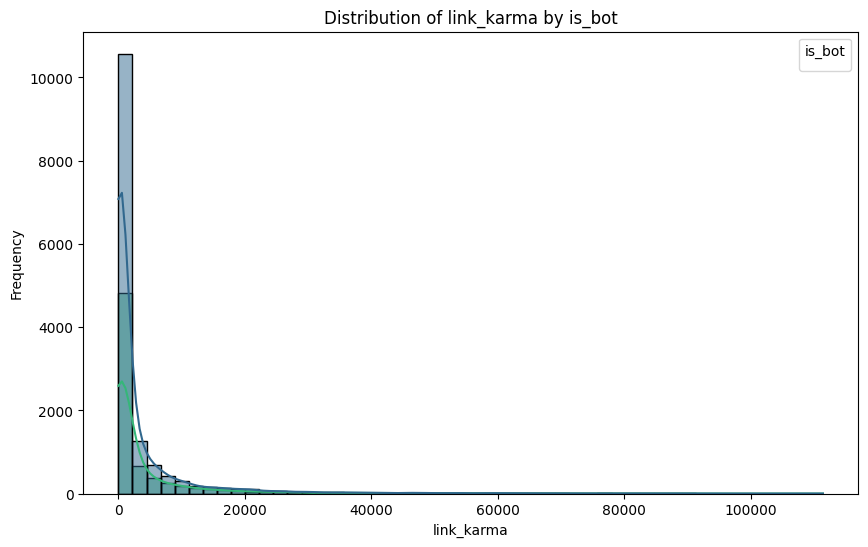

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


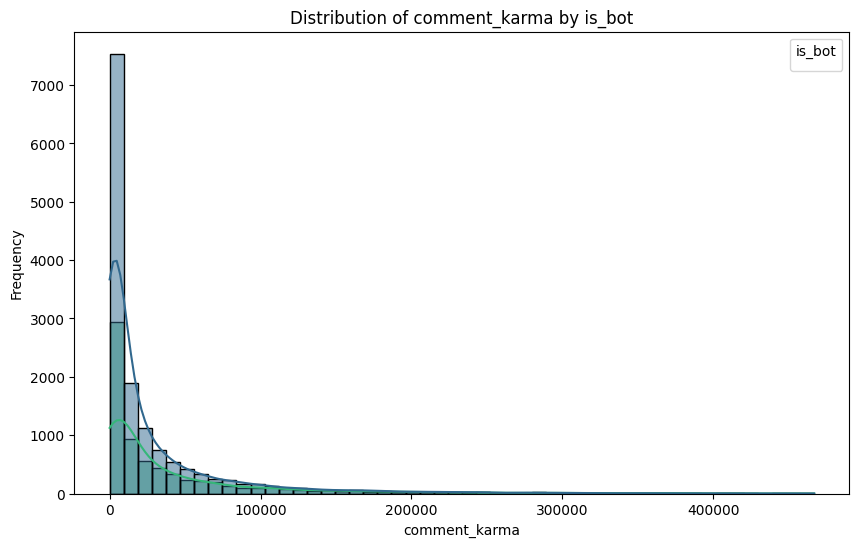

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


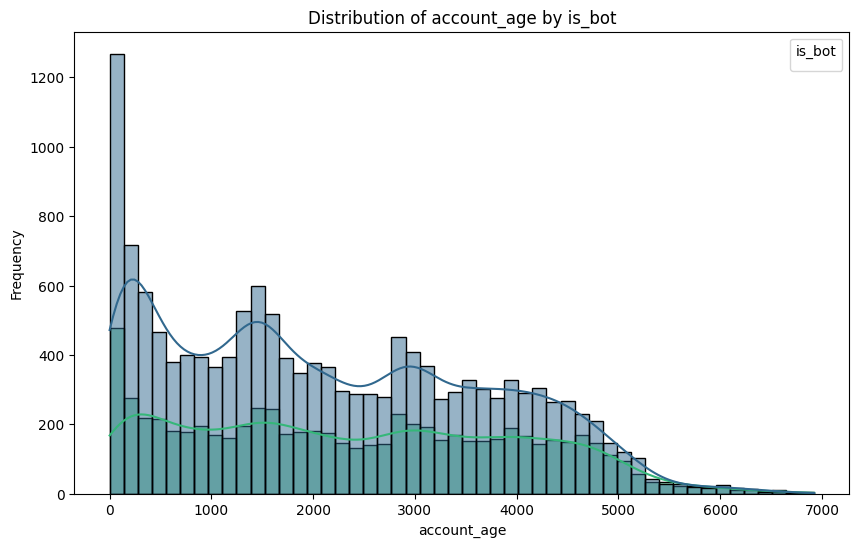

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


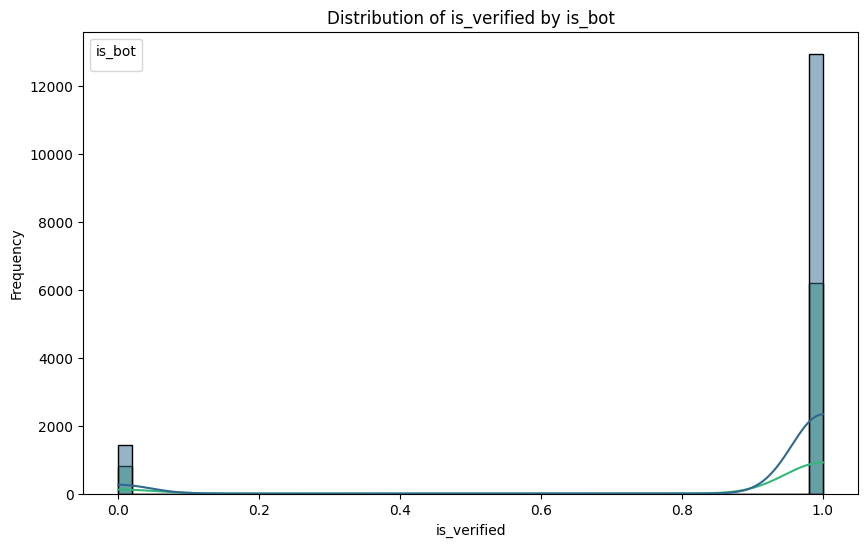

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


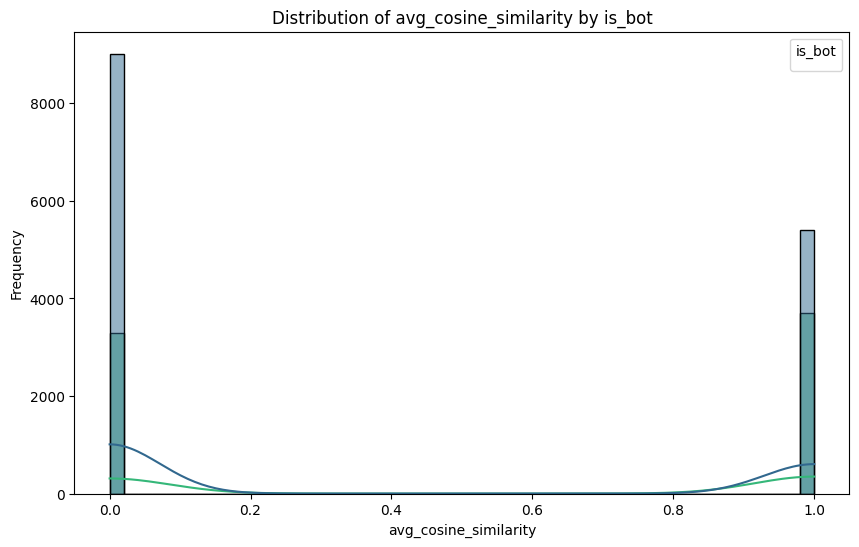

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


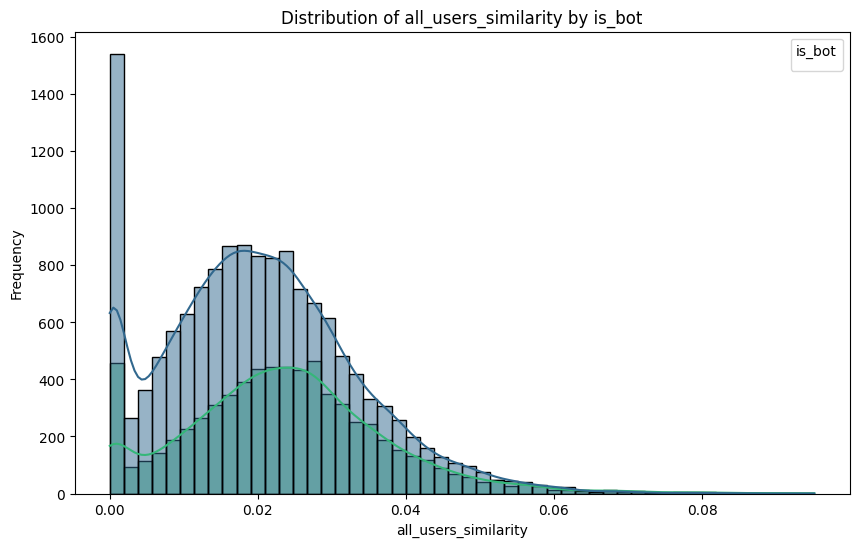

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


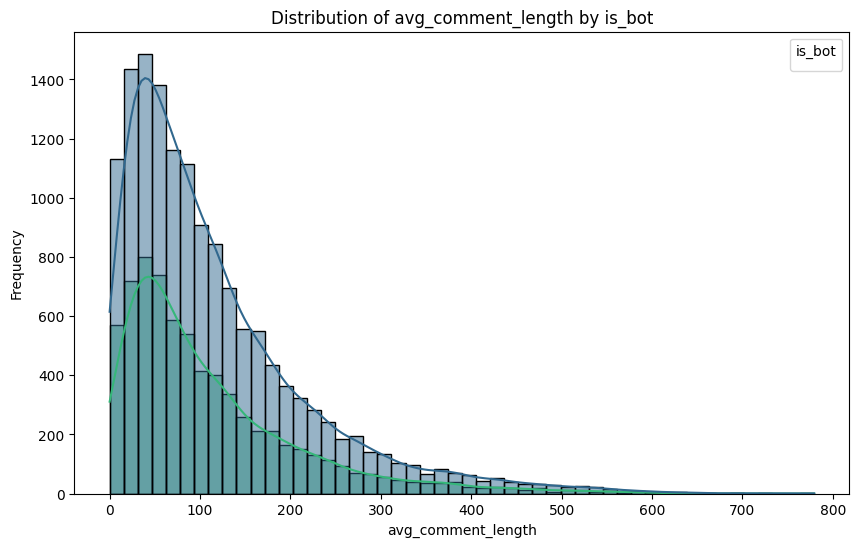

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


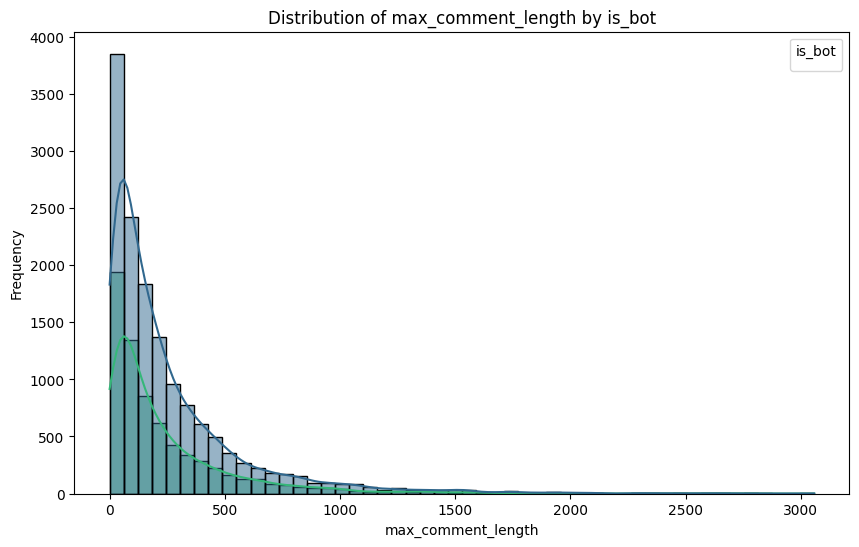

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


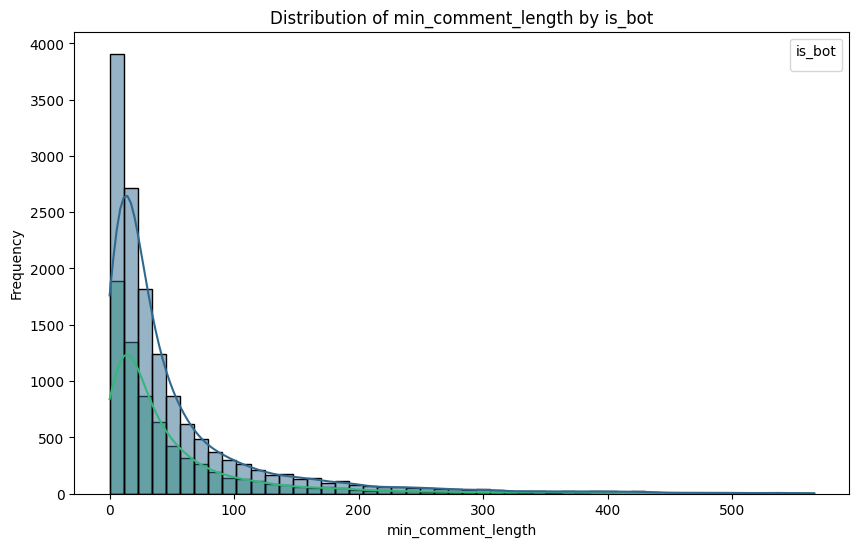

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


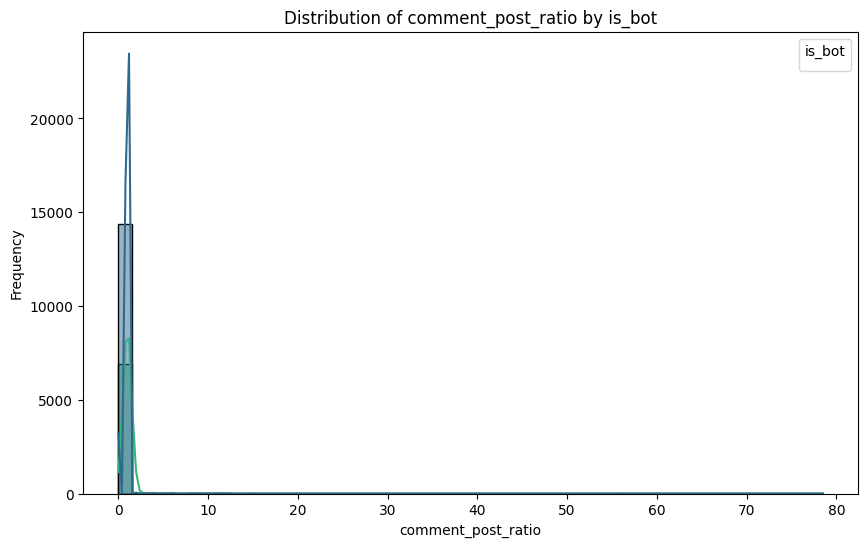

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


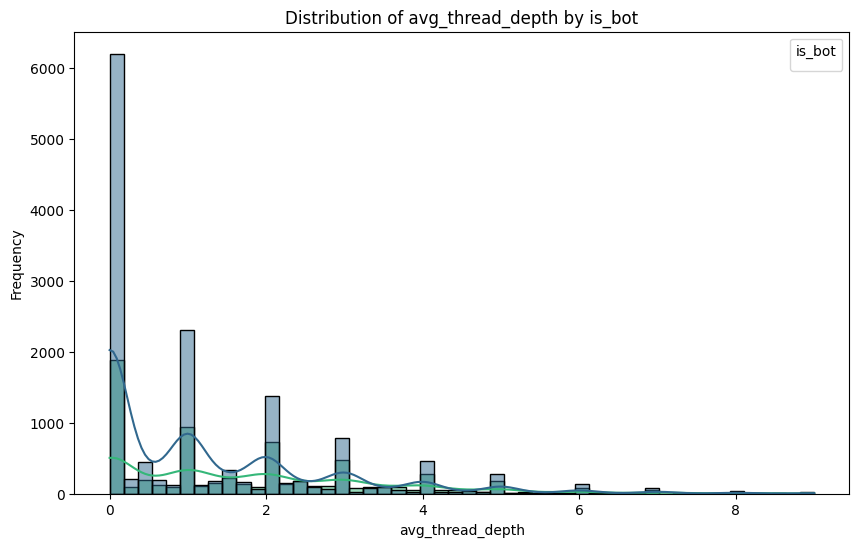

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


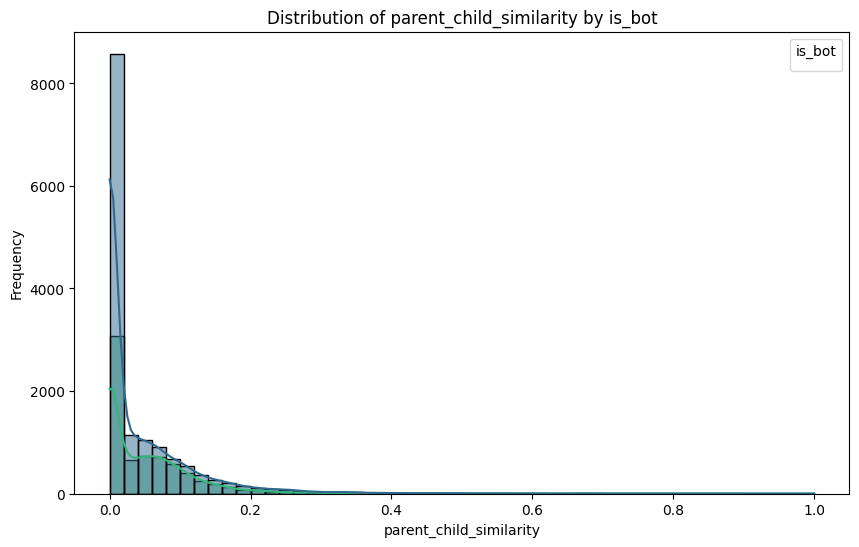

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


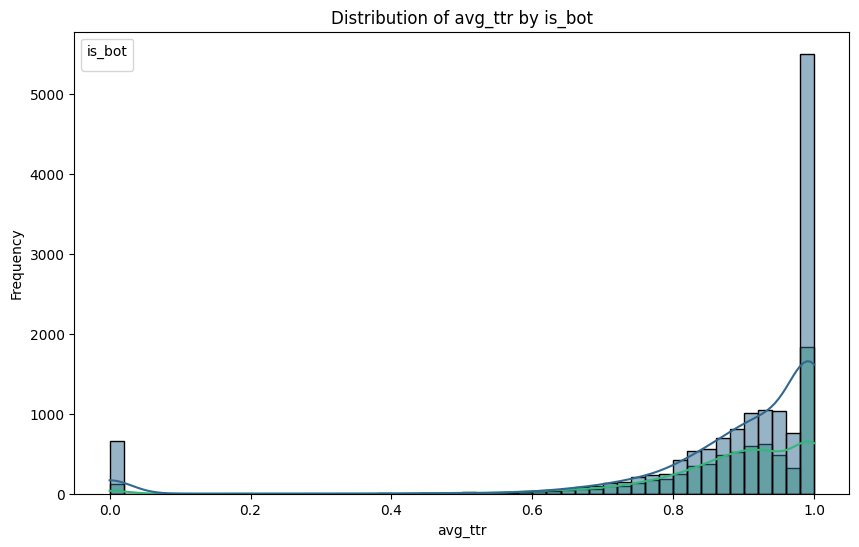

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


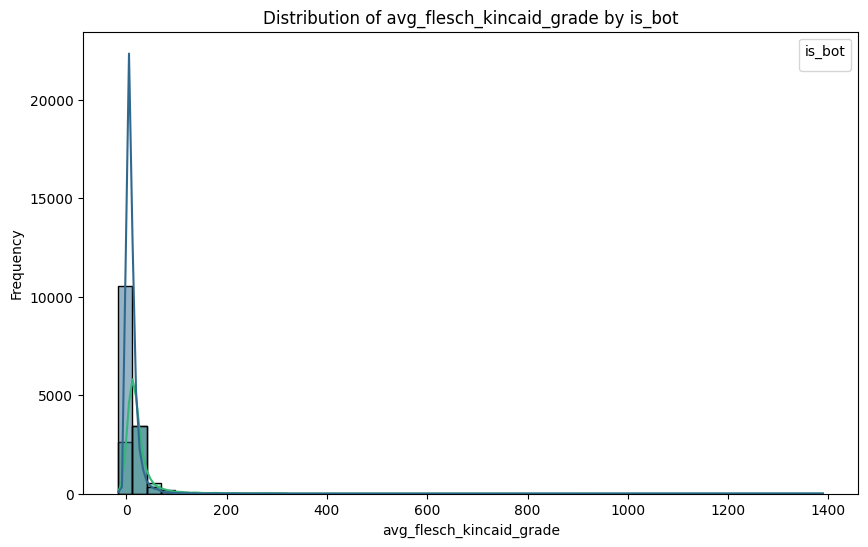

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


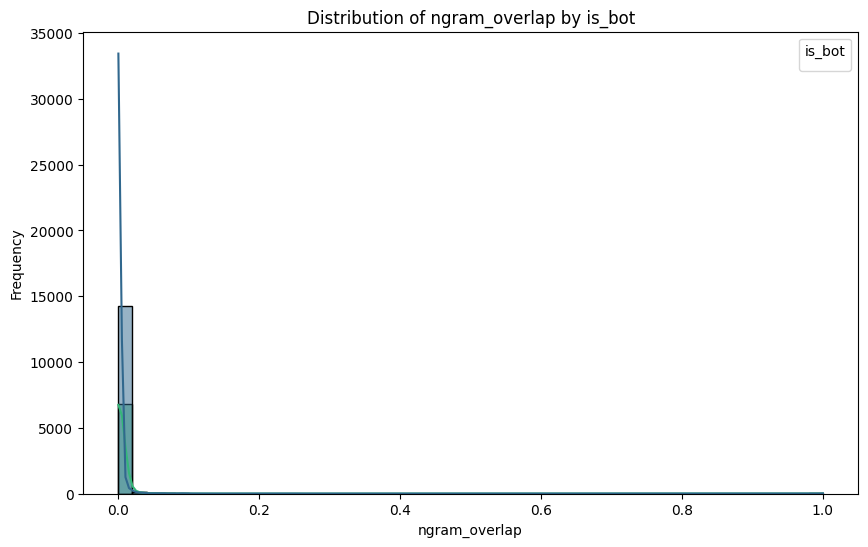

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


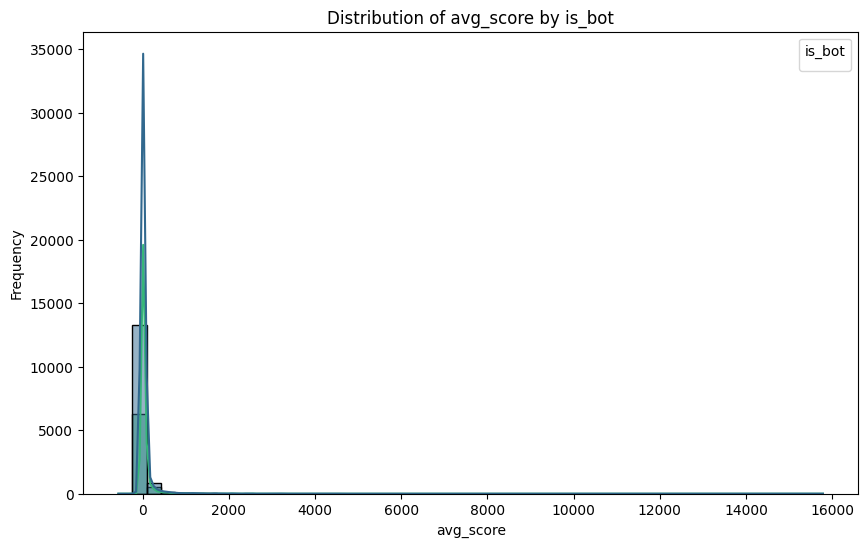

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


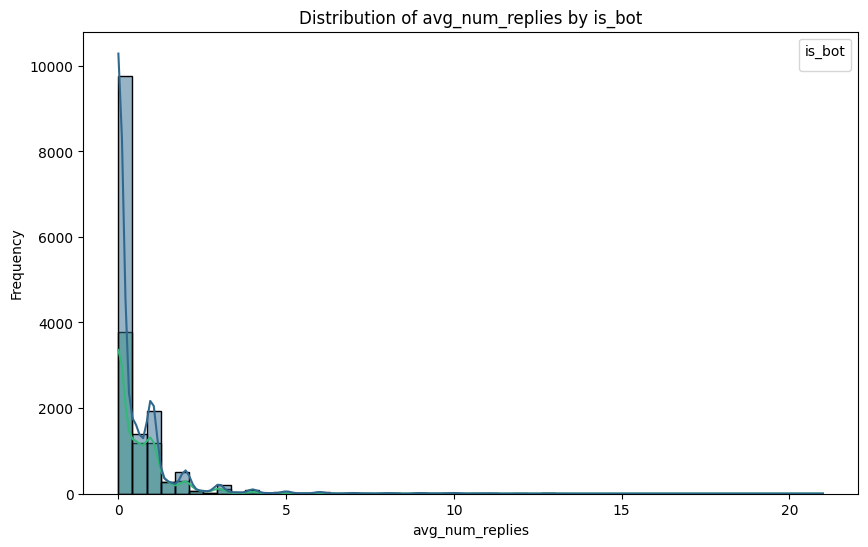

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


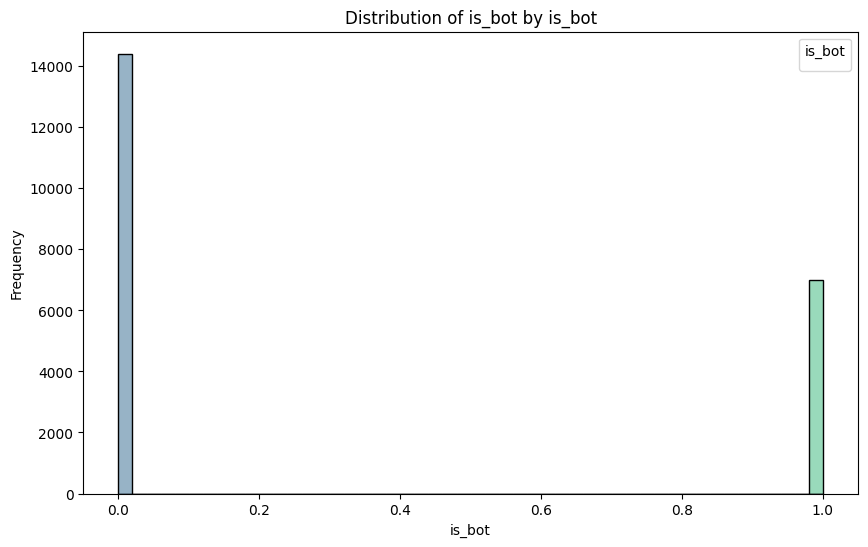

In [24]:
plot_feature_distributions(merged_df, y_df, class_column='is_bot')